In [ ]:
#A Brownian motion sampler capable of resampling a given trajectory. This resampling is only possible due the simplicity
#of the conditional law given two neighbouring points, known as a Brownian bridge. The explicit calculation of this is trivial (yet
#time-consuming). This script samples a path at higher resolution than there are pixels, and zooms in geometrically while resampling
#to maintain super-resolution. The resulting animation, found in the animations folder, is a pixel-perfect Brownian motion trajectory,
#which to the best of my knowledge is the best (most accurate) zoom of a Brownian path on the internet. Since the runtime is independent
#of scale, this can zoom arbitrarily far, almost in real-time (the limiting factor being matplotlib).

import numpy as np
import matplotlib.pyplot as plt

for j in range(140,160):
    print(j)
    z=0.95715996843
    mag=1/2*np.power(z,j)
    
    res=8640+1
    s=4320
    i=int(1/10*152682*2)
    print(i)
    inc=2#int(152682*(1/np.power(z,j+1)-1/np.power(z,j))/500)
    print(inc)
    
    x=np.linspace(1/2-mag,1/2+mag,res)
    y=0*x
    #r1=np.random.normal(0,1,size=(i,1))
    #r2=np.random.normal(0,1,size=(i,1))
    
    r1=np.load("normal coefficients1x1.npy")
    r2=np.load("normal coefficients2x1.npy")
    print(np.size(r1))
    for n in range(1,850000):
        y[0:s]+=r1[n-1]*np.sin(2*n*np.pi*x[0:s])/n
        y[s:]+=r2[n-1]*np.sin(2*n*np.pi*x[s:])/n
    print("resampling done")
    
    #r1=np.append(r1,np.random.normal(0,1,size=(inc,1)))
    #r2=np.append(r2,np.random.normal(0,1,size=(inc,1)))
    #g=0*x
    #for n in range(i+1,i+1+inc):
    #    y[0:s]+=r1[n-1]*np.sin(2*n*np.pi*x[0:s])/n
    #    g[0:s]+=r1[n-1]*np.sin(2*n*np.pi*x[0:s])/n
    #    y[s:]+=r2[n-1]*np.sin(2*n*np.pi*x[s:])/n
    #print(np.max(g))
    #print("inc done")
    
    #np.save("normal coefficients1x1",r1)
    #np.save("normal coefficients2x1",r2)
    
    y=1/np.pi*y
    plt.figure(figsize=(15,15),dpi=1080/15)
    plt.axes
    plt.plot(x-1/2,y)
    plt.grid('minor',alpha=0.3)
    plt.xlim([-mag,mag])
    plt.ylim([-2*np.power(z,j/2.0),2*np.power(z,j/2.0)])
    plt.savefig("BM2zoom"+str(j),dpi=1080/15)

140
30536
2
882384
resampling done
141
30536
2
882384
resampling done
142
30536
2
882384
resampling done
143
30536
2
882384
resampling done
144
30536
2
882384


KeyboardInterrupt: 

1 9468
2 10257
3 11020
4 11759
5 12479
6 13178
7 13858
8 14519
9 15155
10 15777
11 16373
12 16954
13 17521
14 18070
15 18604
16 19124
17 19623
18 20107
19 20582
20 21036


<ipython-input-153-dc5997c5c44b>:44: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(15,15),dpi=1080/15)


21 21475
22 21901
23 22324
24 22723
25 23108
26 23483
27 23849
28 24206
29 24556
30 24895
31 25222
32 25544
33 25845
34 26142
35 26428
36 26711
37 26984
38 27248
39 27509
40 27761
41 28002
42 28231
43 28461
44 28679
45 28894
46 29105
47 29308
48 29497
49 29688
50 29872
51 30048
52 30224
53 30394
54 30557
55 30713
56 30860
57 31016
58 31157
59 31294
60 31438
61 31566
62 31686
63 31813
64 31937
65 32050
66 32169
67 32283
68 32392
69 32500
70 32592
71 32684
72 32769
73 32853
74 32944
75 33033
76 33112
77 33188
78 33261
79 33331
80 33410
81 33486
82 33561
83 33626
84 33696
85 33754
86 33816
87 33876
88 33932
89 33994
90 34049
91 34101
92 34147
93 34189
94 34241
95 34281
96 34325
97 34370
98 34416
99 34453
100 34496
101 34533
102 34564
103 34604
104 34644
105 34679
106 34718
107 34747
108 34781
109 34811
110 34836
111 34870
112 34901
113 34930
114 34957
115 34977
116 34996
117 35014
118 35034
119 35054
120 35073
121 35092
122 35107
123 35128
124 35140
125 35162
126 35184
127 35202
128 35220

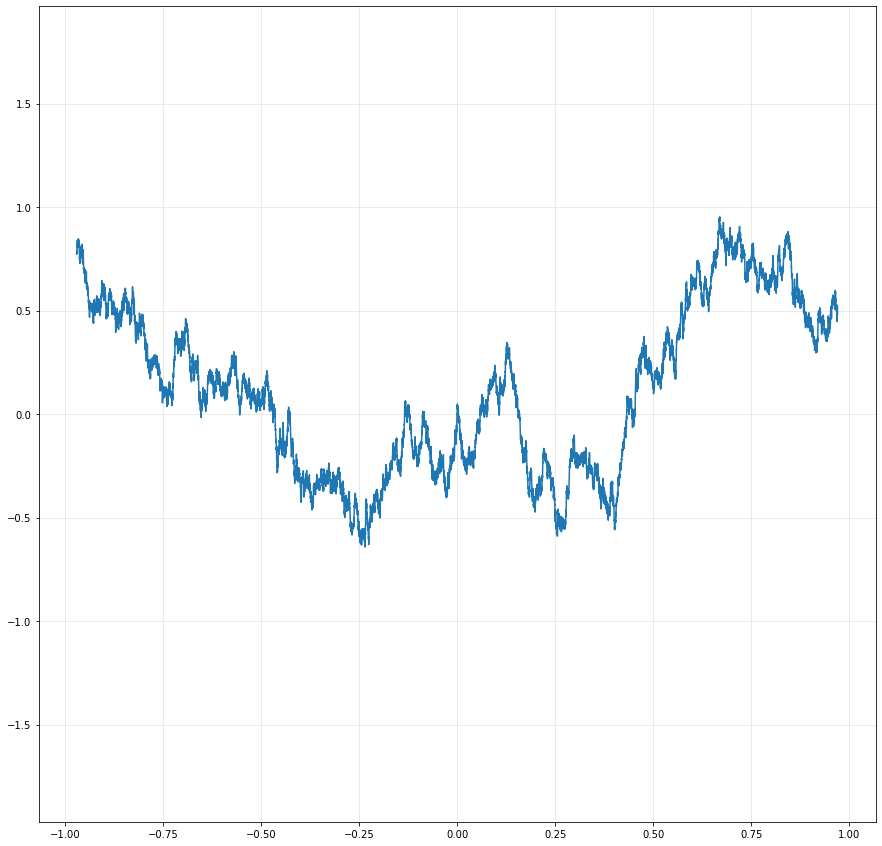

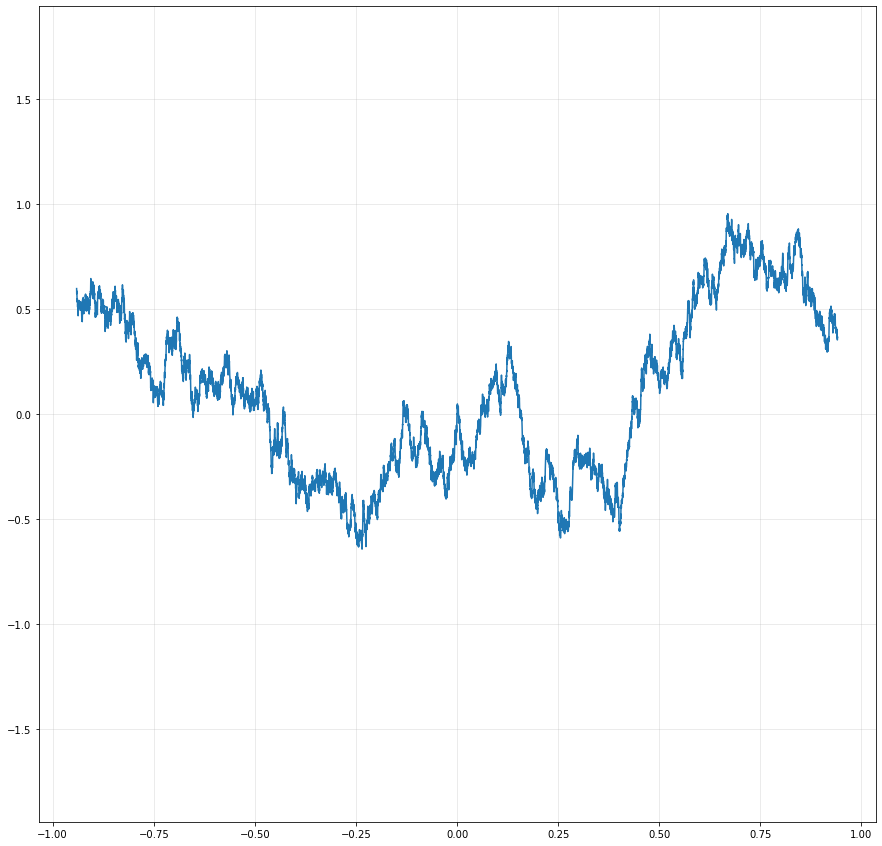

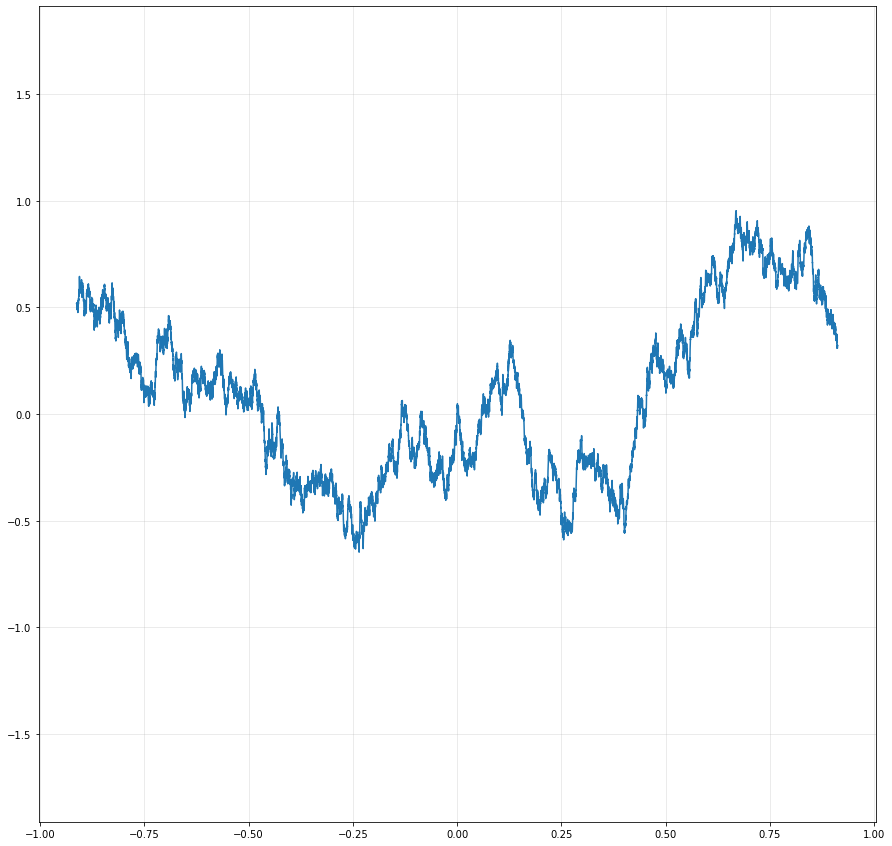

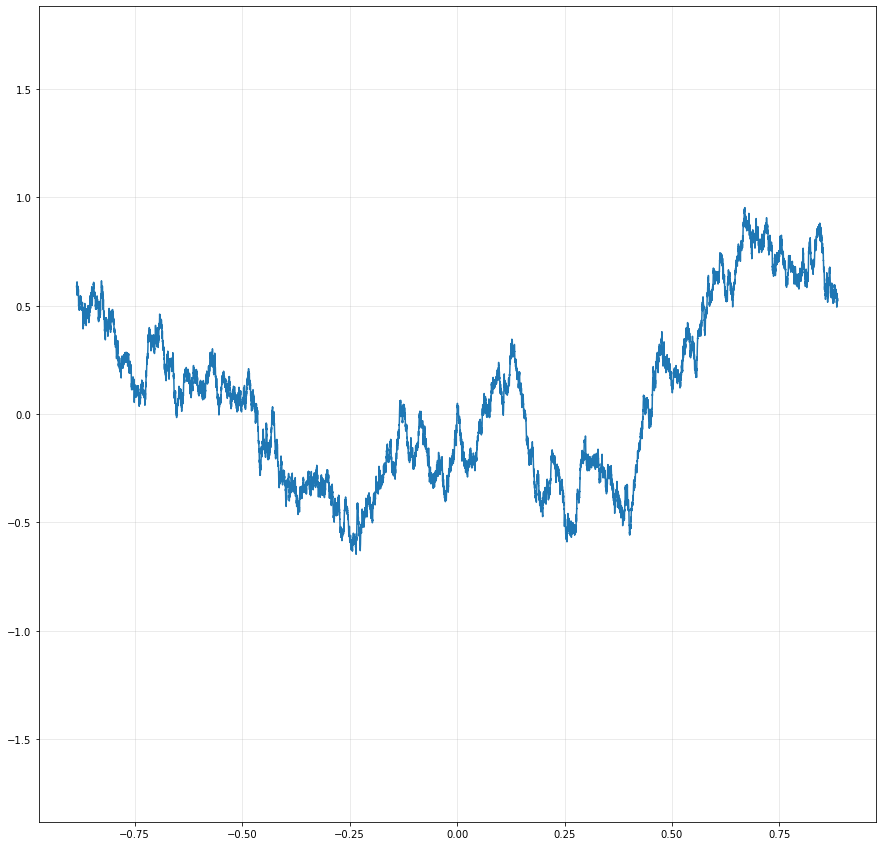

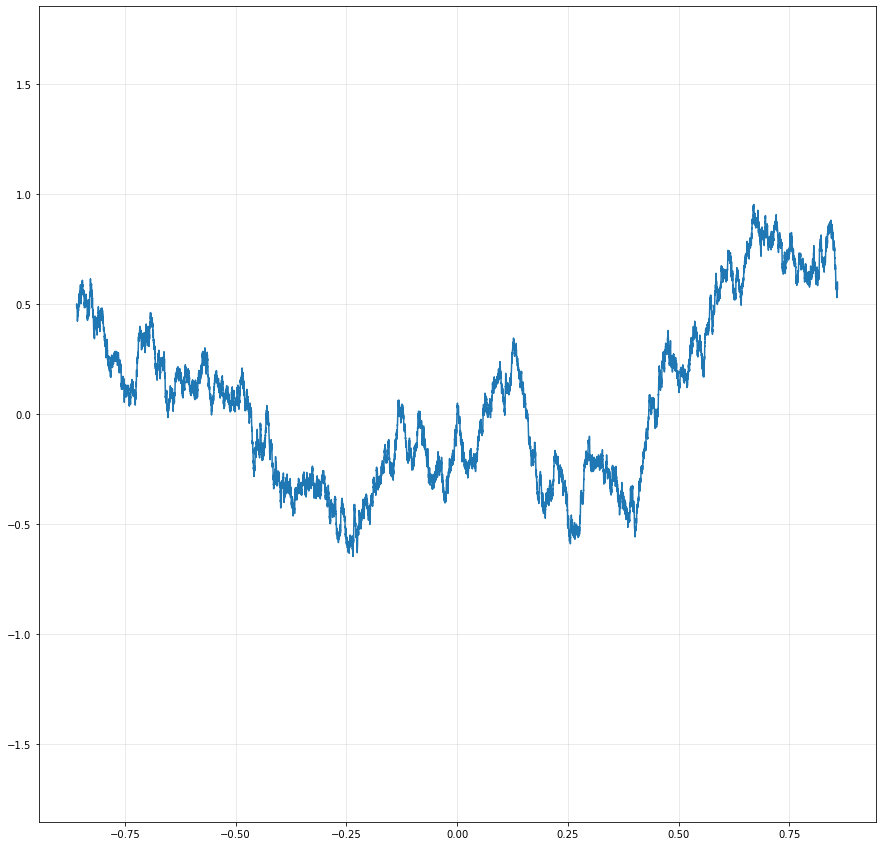

...

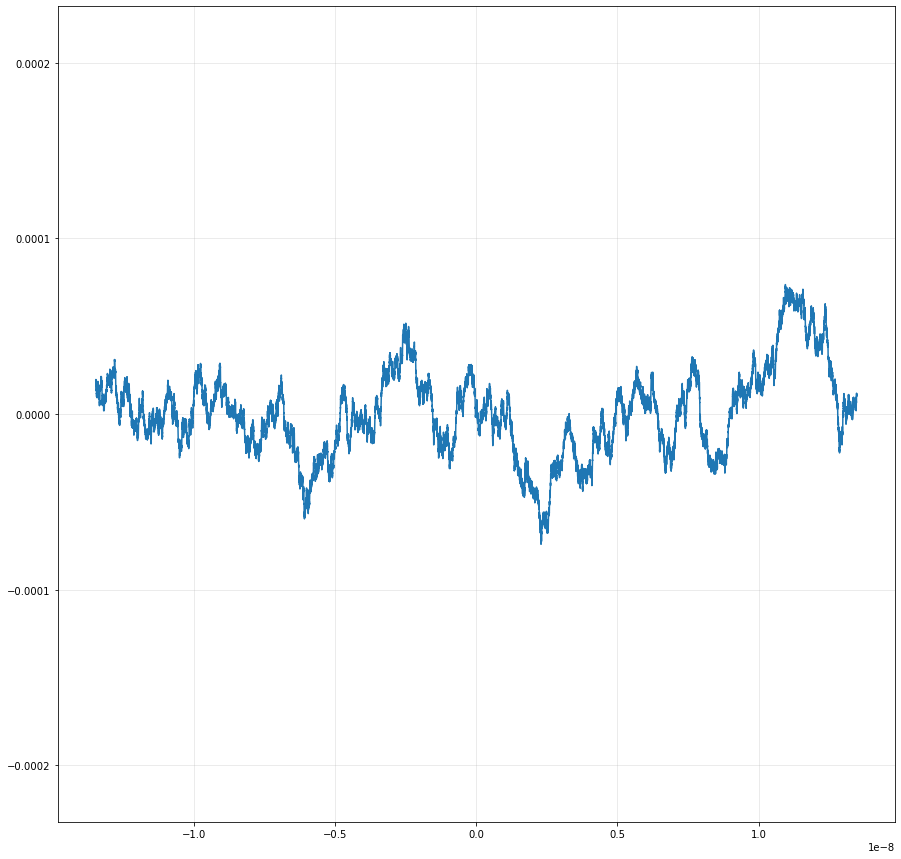

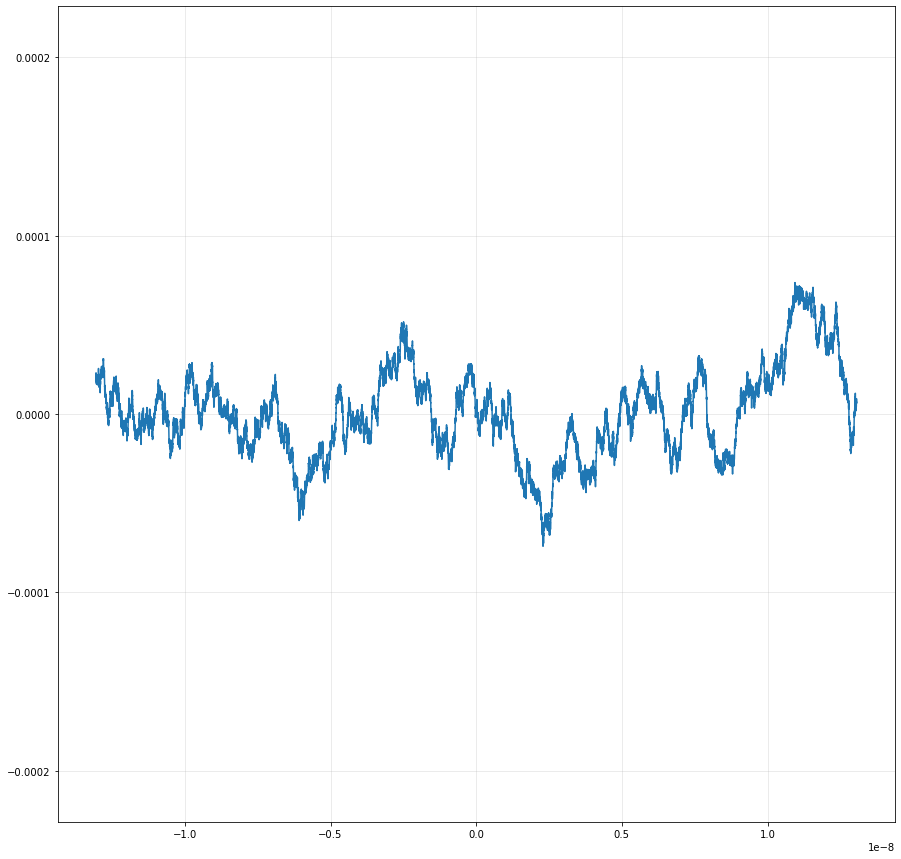

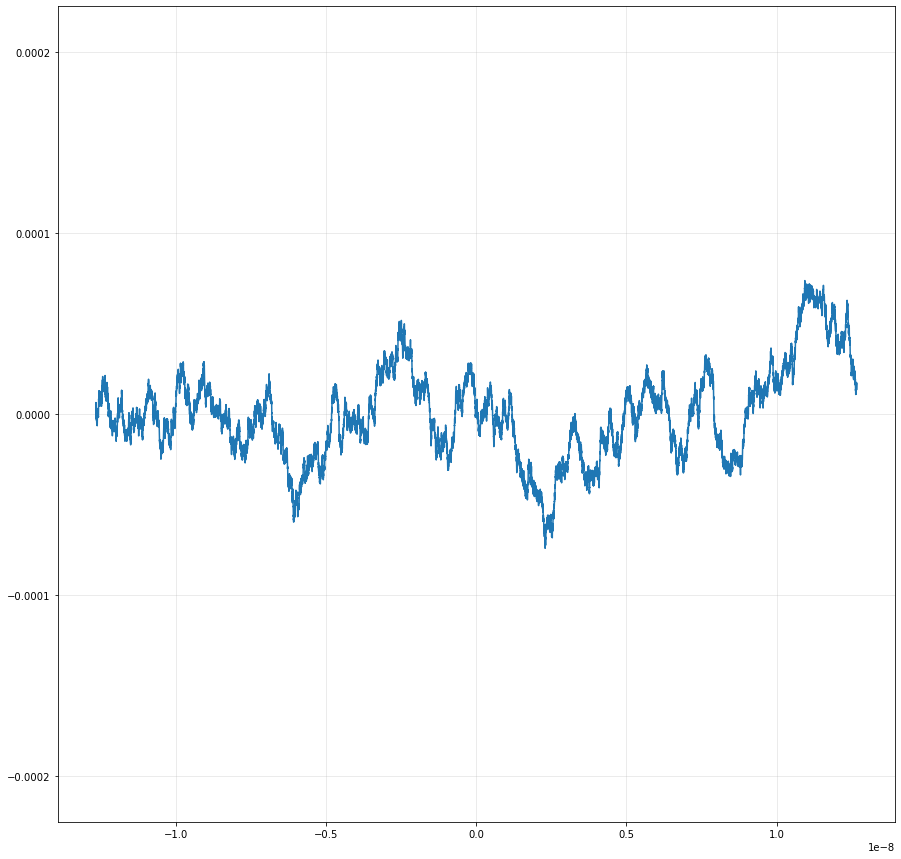

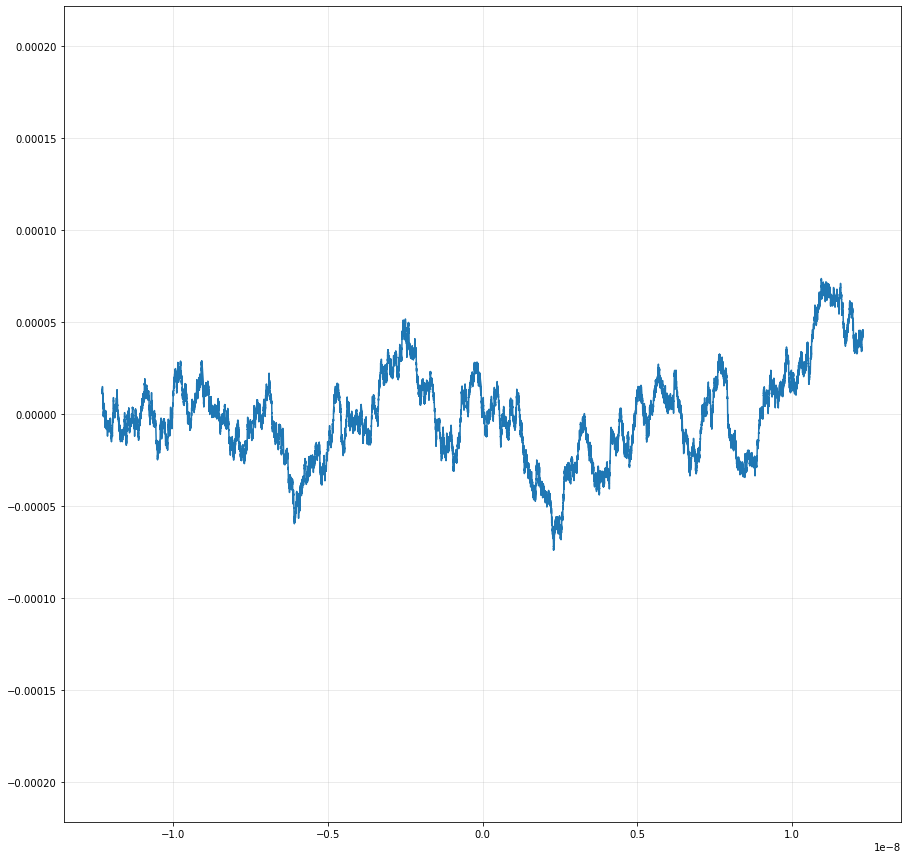

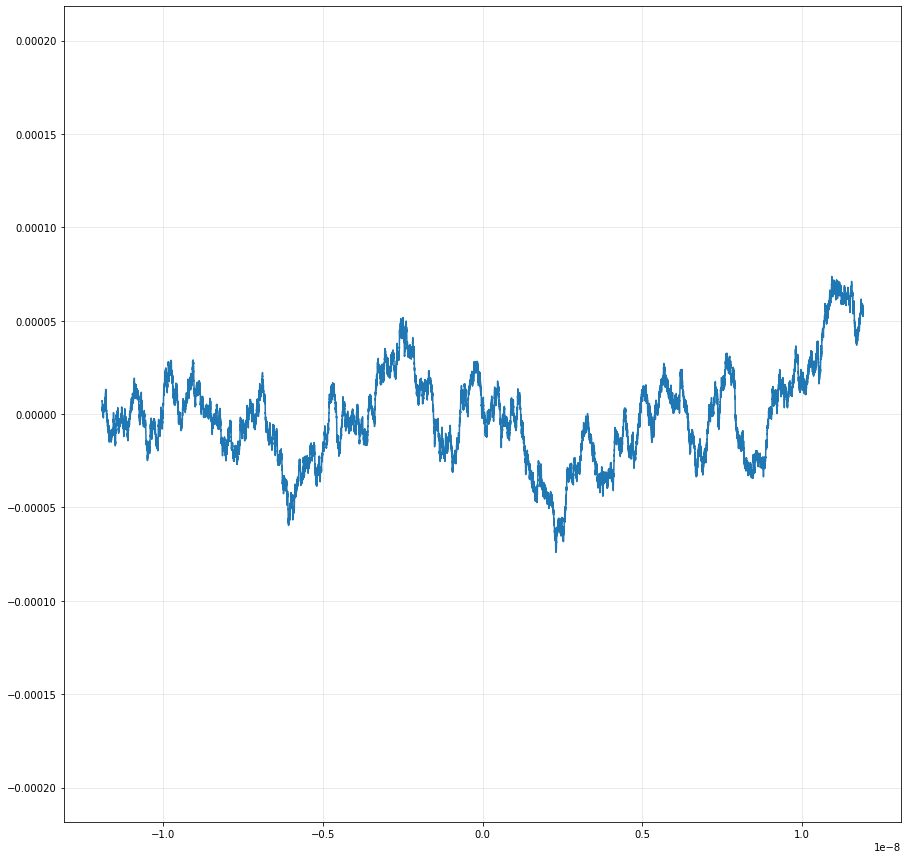

In [153]:
import numpy as np
import matplotlib.pyplot as plt
#import sys
#np.set_printoptions(threshold=sys.maxsize)

N=600
z=0.97
res=1080+1

X1={0:0}
X2={0:0}

l=np.linspace(0,1,8*res)
for k in range(1,8*res):
    X1[l[k]]=np.random.normal(X1[l[k-1]],np.power(1/8*1/res,1/2))
    X2[l[k]]=np.random.normal(X2[l[k-1]],np.power(1/8*1/res,1/2))

for i in range(1,N):
    x1=np.linspace(0,1*np.power(z,i),res)
    x2=np.linspace(0,1*np.power(z,i),res)
    
    for x in x1:
        if x not in X1.keys():
            keys=np.asarray(list(X1.keys()))
            a=np.max(keys[keys<x])
            b=np.min(keys[keys>x])
            X1[x]=np.random.normal(((x-a)*X1[b]+(b-x)*X1[a])/(b-a),np.power(((x-a)*(b-x))/(b-a),1/2))
    
    for x in x2:
        if x not in X2.keys():
            keys=np.asarray(list(X2.keys()))
            a=np.max(keys[keys<x])
            b=np.min(keys[keys>x])
            X2[x]=np.random.normal(((x-a)*X2[b]+(b-x)*X2[a])/(b-a),np.power(((x-a)*(b-x))/(b-a),1/2))

    X=np.asarray(list(X1.items()))
    X=X[np.lexsort(X.T[::-1])]
    X=X[X[:,0]<np.power(z,i)]
    Y=np.asarray(list(X2.items()))
    Y=-Y[np.lexsort(-Y.T[::-1])]
    Y=Y[Y[:,0]>-np.power(z,i)][:-1,:]
    final=np.append(Y,X,axis=0)
    
    plt.figure(figsize=(15,15),dpi=1080/15)
    plt.plot(final[:,0],final[:,1])
    plt.ylim(-2*np.power(z,i/2),2*np.power(z,i/2))
    plt.grid('minor',alpha=0.3)
    plt.savefig("BM3fastzoom"+str(i),dpi=1080/15)
    
    for key in list(X1):
        if np.abs(key)>np.power(z,i):
            X1.pop(key)
    for key in list(X2):
        if np.abs(key)>np.power(z,i):
            X2.pop(key)
    print(str(i)+" "+str(len(X1)))